# LA Crime Data EDA and Hotspot Detection with HDBSCAN

A step-by-step exploratory data analysis (EDA) and spatial clustering workflow on Los Angeles crime data, with visualizations and interactive maps.

---
## Data Overview

**Description:**

This dataset provides a detailed account of crime incidents reported in the City of Los Angeles from 2020 to the present day. The data is compiled from the Los Angeles Police Department (LAPD) and includes various features like the type of crime, date and time of occurrence, location, and demographic information of victims. With over four years of data, this dataset is invaluable for researchers, data scientists, and analysts who are interested in studying crime trends, identifying patterns, and developing predictive models to enhance public safety.

This dataset reflects incidents of crime in the City of Los Angeles dating back to 2020. The data is transcribed from original crime reports that are typed on paper, which may introduce some inaccuracies. Location fields with missing data are noted as (0°, 0°), and address fields are provided only to the nearest hundred block to maintain privacy. This data is as accurate as the data in the database.
## Data Source

The dataset used in this analysis is publicly available on Kaggle:

[Crime Incidents in Los Angeles (2020 to Present) – Kaggle](https://www.kaggle.com/datasets/saurabhbadole/crime-incidents-in-los-angeles-2020-to-present)

###  Import Libraries

Import all necessary Python libraries for data manipulation, visualization, mapping, clustering, and preprocessing.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap
import hdbscan
from sklearn.preprocessing import StandardScaler
import ipywidgets as widgets
from IPython.display import display


import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

### Data Setup
Load the LA crime dataset from a CSV file into a pandas DataFrame.

In [2]:
df = pd.read_csv('DATA/Crime_Data_from_2020_to_Present.csv')

#### Basic Data Overview
Display the shape and columns of the dataset to understand its structure.

In [3]:
print("Dataset Shape:", df.shape)
print("\nColumns:\n", df.columns)

Dataset Shape: (966951, 28)

Columns:
 Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Crm Cd Desc', 'Mocodes',
       'Vict Age', 'Vict Sex', 'Vict Descent', 'Premis Cd', 'Premis Desc',
       'Weapon Used Cd', 'Weapon Desc', 'Status', 'Status Desc', 'Crm Cd 1',
       'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4', 'LOCATION', 'Cross Street', 'LAT',
       'LON'],
      dtype='object')


####  Preview Data
Show the first five rows to get an initial look at the data

In [4]:
print("\nFirst 5 Rows:\n")
df.head()


First 5 Rows:



,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,190326475,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,AA,Adult Arrest,510.0,998.0,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506
1,200106753,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,IC,Invest Cont,330.0,998.0,NaN,NaN,1000 S FLOWER ST,NaN,34.0444,-118.2628
2,200320258,11/11/2020 12:00:00 AM,11/04/2020 12:00:00 AM,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,IC,Invest Cont,480.0,NaN,NaN,NaN,1400 W 37TH ST,NaN,34.0210,-118.3002
3,200907217,05/10/2023 12:00:00 AM,03/10/2020 12:00:00 AM,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,IC,Invest Cont,343.0,NaN,NaN,NaN,14000 RIVERSIDE DR,NaN,34.1576,-118.4387
4,220614831,08/18/2022 12:00:00 AM,08/17/2020 12:00:00 AM,1200,6,Hollywood,666,2,354,THEFT OF IDENTITY,...,IC,Invest Cont,354.0,NaN,NaN,NaN,1900 TRANSIENT,NaN,34.0944,-118.3277


### Data Cleaning

This step ensures the dataset is ready for analysis:
- Remove rows with missing or invalid latitude/longitude.
- Convert coordinate columns to numeric types.
- Drop any remaining invalid entries.

In [5]:
df = df.dropna(subset=['LAT', 'LON'])

#### Ensure Numeric Coordinates
Convert latitude and longitude columns to numeric types, coercing errors to NaN.

In [6]:
df['LAT'] = pd.to_numeric(df['LAT'], errors='coerce')
df['LON'] = pd.to_numeric(df['LON'], errors='coerce')

#### Drop Rows with Invalid Coordinates
Drop any rows that still have invalid (NaN) latitude or longitude values after conversion.

In [7]:
df = df.dropna(subset=['LAT', 'LON'])

## Exploratory Data Analysis

### Crimes by Type
Visualize the top 15 most common crime types in Los Angeles.



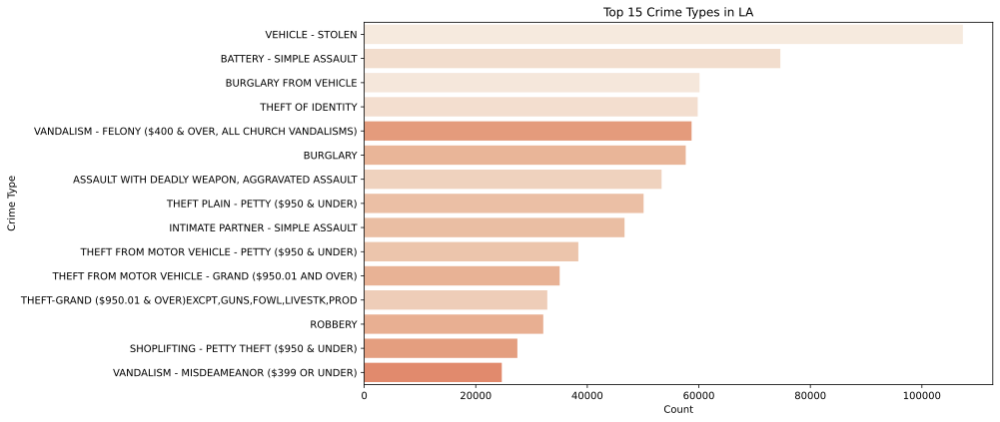

In [8]:
plt.figure(figsize=(14,6))
sns.countplot(
    y=df['Crm Cd Desc'], 
    order=df['Crm Cd Desc'].value_counts().iloc[:15].index,
    hue=df['Crm Cd Desc'],
    palette='rocket_r')

plt.title('Top 15 Crime Types in LA')
plt.xlabel('Count')
plt.ylabel('Crime Type')
plt.tight_layout()

### Temporal Patterns

Analyze how crime frequency varies over years and months.

- **Yearly Trends:** Spot increases or decreases in overall crime.
- **Monthly Patterns:** Identify seasonal fluctuations.


####  Convert Date Column
Convert the date column to a datetime object for time-based analysis.

In [9]:
df['DATE OCC'] = pd.to_datetime(df['DATE OCC'], format='%m/%d/%Y %I:%M:%S %p', errors='coerce')

### Crimes per Year
Plot the number of crimes per year.

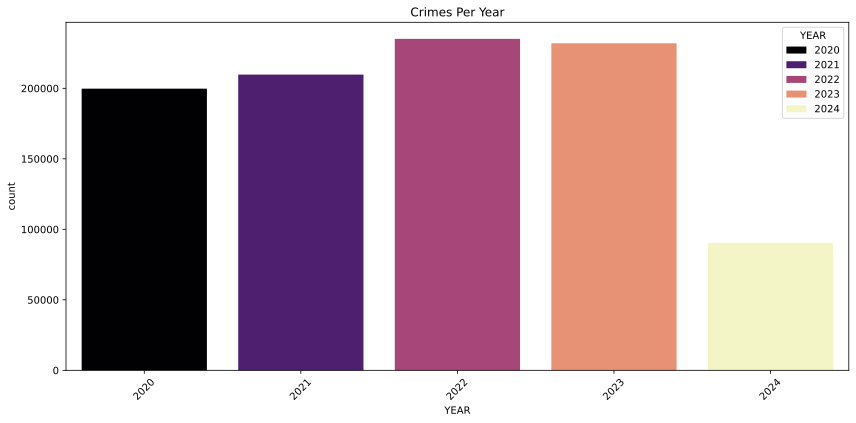

In [10]:
plt.figure(figsize=(12,6))
df['YEAR'] = df['DATE OCC'].dt.year
sns.countplot(x='YEAR', data=df, hue='YEAR', palette='magma')
plt.title('Crimes Per Year')
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('visualisations/crimes_per_year.svg')

### Crimes per Month
Plot the number of crimes per month.



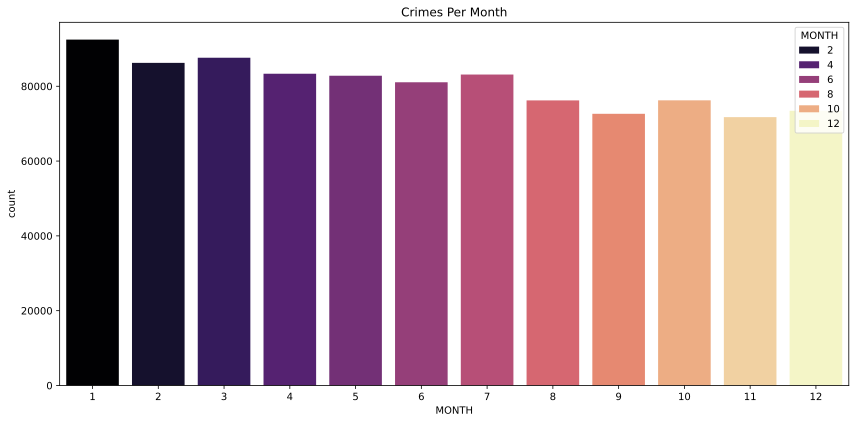

In [11]:
plt.figure(figsize=(12,6))
df['MONTH'] = df['DATE OCC'].dt.month
sns.countplot(x='MONTH', data=df,hue='MONTH',palette='magma')
plt.title('Crimes Per Month')
plt.tight_layout()
plt.savefig('visualisations/crimes_per_month.svg')

### Victim Demographics

- **Age Distribution:** See which age groups are most affected.
- **Gender Distribution:** Examine the gender breakdown of victims.


### Age Distribution
Visualize the distribution of victim ages.

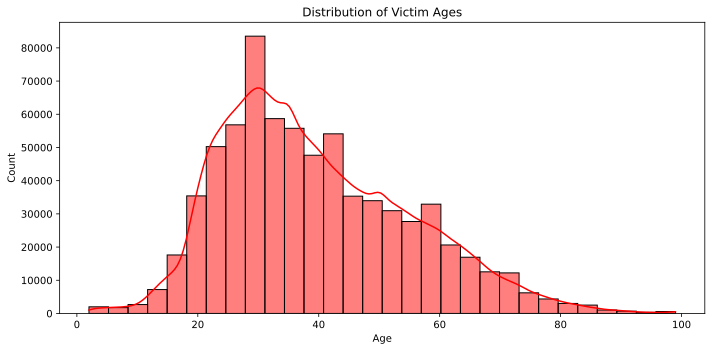

In [12]:
# Filter for realistic ages
valid_ages = df['Vict Age'][(df['Vict Age'] > 0) & (df['Vict Age'] <= 100)]

plt.figure(figsize=(10,5))
sns.histplot(valid_ages, bins=30, kde=True, color='r')
plt.title('Distribution of Victim Ages')
plt.xlabel('Age')
plt.tight_layout()
plt.savefig('visualisations/victim_ages.svg')

#### Gender Distribution
The distribution of victim genders.

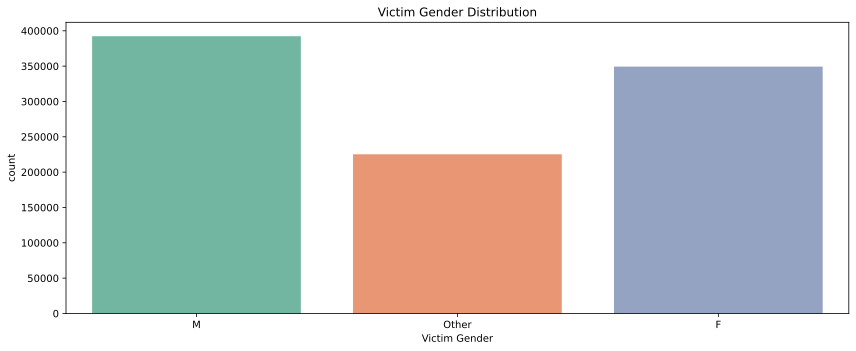

In [13]:
df['Vict Sex Simplified'] = df['Vict Sex'].apply(
    lambda x: 'M' if x == 'M' else ('F' if x == 'F' else 'Other')
)

plt.figure(figsize=(12,5))
sns.countplot(x='Vict Sex Simplified', data=df,hue='Vict Sex Simplified',palette='Set2')
plt.xlabel('Victim Gender')
plt.title('Victim Gender Distribution')
plt.tight_layout()
plt.savefig('visualisations/victim_sex.png')


## 8. Spatial Clustering with HDBSCAN

Apply the HDBSCAN clustering algorithm to detect geographic crime hotspots.

- **Coordinate Preparation:** Extract and standardize latitude/longitude.
- **Clustering:** Assign cluster labels to each incident.
- **Result:** Number of unique clusters (hotspots) is displayed.


### Preparing Coordinates
Extracting latitude and longitude as a NumPy array for clustering.

In [14]:
coords = df[['LAT', 'LON']].to_numpy()

#### Standardized Coordinates
Standardizing the coordinate data for better clustering performance.

In [15]:
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(coords)

### HDBSCAN Clustering
Apply HDBSCAN clustering to identify spatial crime hotspots.



In [16]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=3000, min_samples=30, metric='euclidean')
cluster_labels = clusterer.fit_predict(coords_scaled)

### Assign Clusters to DataFrame
Assign cluster labels back to the DataFrame and print the number of clusters found.

In [17]:
df['Cluster'] = cluster_labels
print("\nUnique Clusters Found:", df['Cluster'].nunique())
print(df['Cluster'].value_counts())


Unique Clusters Found: 8
Cluster
 5    634324
 6    258274
-1     20305
 0     17718
 3     16393
 2     10838
 1      5998
 4      3101
Name: count, dtype: int64


##  Crime Heatmap

Create a heatmap to visualize overall crime density across Los Angeles.

- High-density areas appear brighter.
- The heatmap is saved as an HTML file.


In [18]:
heatmap_map = folium.Map(location=[34.0522, -118.2437], zoom_start=11)
HeatMap(data=coords, radius=8, blur=15).add_to(heatmap_map)
heatmap_map 

In [19]:
crime_type = 'BURGLARY FROM VEHICLE'
filtered_df = df[df['Crm Cd Desc'] == crime_type]

# heatmap for this crime type
filtered_coords = filtered_df[['LAT', 'LON']].to_numpy()
heatmap_map = folium.Map(location=[34.0522, -118.2437], zoom_start=11)
HeatMap(data=filtered_coords, radius=8, blur=15).add_to(heatmap_map)
heatmap_map 

In [20]:
# Filter for crimes in 2024
filtered_df = df[df['YEAR'] == 2024]

filtered_coords = filtered_df[['LAT', 'LON']].to_numpy()
heatmap_map = folium.Map(location=[34.0522, -118.2437], zoom_start=11)
HeatMap(data=filtered_coords, radius=8, blur=15).add_to(heatmap_map)
heatmap_map

In [21]:
# Filter for Female victims
filtered_df = df[df['Vict Sex Simplified'] == 'F']

filtered_coords = filtered_df[['LAT', 'LON']].to_numpy()
heatmap_map = folium.Map(location=[34.0522, -118.2437], zoom_start=11)
HeatMap(data=filtered_coords, radius=8, blur=15).add_to(heatmap_map)
heatmap_map

In [22]:
# Filter for Female victims of burglary in 2024
filtered_df = df[
    (df['Crm Cd Desc'] == 'BURGLARY FROM VEHICLE') &
    (df['YEAR'] == 2024) &
    (df['Vict Sex Simplified'] == 'F')
]

filtered_coords = filtered_df[['LAT', 'LON']].to_numpy()
heatmap_map = folium.Map(location=[34.0522, -118.2437], zoom_start=11)
HeatMap(data=filtered_coords, radius=8, blur=15).add_to(heatmap_map)
heatmap_map

## 🎛️ Play With the Data! (Interactive Map Filters)

Want to explore LA crime your way? Use the dropdowns below to pick a crime type, year, and victim gender—then watch the map update instantly! Try different combos and see what patterns you can spot.  
_Tip: If you don’t see anything interesting, try a more common crime or a different year!_

In [23]:
import folium
from folium.plugins import HeatMap
import ipywidgets as widgets
from IPython.display import display

# Prepare widget options
crime_types = sorted(df['Crm Cd Desc'].dropna().unique())
years = sorted(df['YEAR'].dropna().unique())
genders = ['Any'] + sorted(df['Vict Sex Simplified'].dropna().unique())

# Create widgets
crime_dropdown = widgets.Dropdown(options=['Any'] + crime_types, description='Crime:')
year_dropdown = widgets.Dropdown(options=['Any'] + [int(y) for y in years], description='Year:')
gender_dropdown = widgets.Dropdown(options=genders, description='Gender:')

# Function to update map
def update_map(crime, year, gender):
    filtered = df.copy()
    if crime != 'Any':
        filtered = filtered[filtered['Crm Cd Desc'] == crime]
    if year != 'Any':
        filtered = filtered[filtered['YEAR'] == year]
    if gender != 'Any':
        filtered = filtered[filtered['Vict Sex Simplified'] == gender]
    coords = filtered[['LAT', 'LON']].dropna().to_numpy()
    fmap = folium.Map(location=[34.0522, -118.2437], zoom_start=11)
    if len(coords) > 0:
        HeatMap(coords, radius=8, blur=15).add_to(fmap)
    else:
        fmap.fit_bounds([[34.0522, -118.2437], [34.0522, -118.2437]])
    display(fmap)

# Interactive output
ui = widgets.VBox([crime_dropdown, year_dropdown, gender_dropdown])
out = widgets.interactive_output(
    update_map, {'crime': crime_dropdown, 'year': year_dropdown, 'gender': gender_dropdown}
)

display(ui, out)

Output()

# 📊 Project Conclusion: LA Crime Data EDA & Hotspot Detection

Through this project, we explored and analyzed over four years of crime data from Los Angeles, applying advanced spatial clustering and interactive mapping to reveal meaningful patterns and hotspots. Here’s what we accomplished:

- **Cleaned and prepared** a large, real-world dataset for analysis.
- **Visualized crime trends** by type, time, and victim demographics, uncovering how crime varies across the city and over time.
- **Applied HDBSCAN clustering** to detect spatial hotspots, identifying key areas with high concentrations of criminal activity.
- **Created interactive maps** (both cluster and heatmap visualizations) for deep, intuitive exploration of spatial trends.
- **Enabled flexible filtering** using ipywidgets, empowering users to slice and dice the data by crime type, year, and victim gender.

**Key Insights:**
- Crime is distributed throughout LA, but certain neighborhoods consistently emerge as hotspots.
- Temporal and demographic filters reveal unique patterns (e.g., some crimes cluster in specific months or affect certain groups more).
- Interactive visualizations make it easy to communicate findings and support data-driven decision-making for public safety.
---

Thank you for exploring LA crime data with this project! 🚦
